# Importing the required libraries

In [35]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Loading the dataset to the pandas dataframe.

In [36]:
df = pd.read_csv('https://raw.githubusercontent.com/santhoshsai3/CMPE255-TermProject/main/ratings_Beauty.csv')


# Summary of Dataset

In [37]:
print("shape of the dataset :" , df.shape)
(rows,cols) = df.shape
print("The number of rows : ", rows)
print("The number of columns : ", cols)

shape of the dataset : (2023070, 4)
The number of rows :  2023070
The number of columns :  4


In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2023070 entries, 0 to 2023069
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   UserId     object 
 1   ProductId  object 
 2   Rating     float64
 3   Timestamp  int64  
dtypes: float64(1), int64(1), object(2)
memory usage: 61.7+ MB


In [39]:
df.describe()

,Rating,Timestamp
count,2.023070e+06,2.023070e+06
mean,4.149036e+00,1.360389e+09
std,1.311505e+00,4.611860e+07
min,1.000000e+00,9.087552e+08
25%,4.000000e+00,1.350259e+09
50%,5.000000e+00,1.372810e+09
75%,5.000000e+00,1.391472e+09
max,5.000000e+00,1.406074e+09


In [40]:
#displaying the dataset
df

,UserId,ProductId,Rating,Timestamp
0,A39HTATAQ9V7YF,0205616461,5.0,1369699200
1,A3JM6GV9MNOF9X,0558925278,3.0,1355443200
2,A1Z513UWSAAO0F,0558925278,5.0,1404691200
3,A1WMRR494NWEWV,0733001998,4.0,1382572800
4,A3IAAVS479H7M7,0737104473,1.0,1274227200
...,...,...,...,...
2023065,A3DEHKPFANB8VA,B00LORWRJA,5.0,1405296000
2023066,A3DEHKPFANB8VA,B00LOS7MEE,5.0,1405296000
2023067,AG9TJLJUN5OM3,B00LP2YB8E,5.0,1405382400
2023068,AYBIB14QOI9PC,B00LPVG6V0,5.0,1405555200


In [41]:
#checking for the data integriety by finding the duplicate rows.
duplicates = df.duplicated(["UserId","ProductId", "Rating", "Timestamp"]).sum()
print(' Duplicate records: ',duplicates)

 Duplicate records:  0


In [42]:
#Printing the number of unique users
print('unique users:',len(df['UserId'].unique()))



unique users: 1210271


In [43]:
#Printing the number of unique products
print('unique products:',len(df['ProductId'].unique()))


unique products: 249274


In [44]:
#Printing the number of unique ratings
print('unique ratings:',len(df['Rating'].unique()))

unique ratings: 5


# Handling null values

In [45]:
df.isnull().any()

UserId       False
ProductId    False
Rating       False
Timestamp    False
dtype: bool

#Data Analysis

In [46]:
#Number of rated products per user

prod_per_user= df.groupby(by = "UserId")["Rating"].count().sort_values(ascending =False)
prod_per_user.head()

UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
Name: Rating, dtype: int64

In [47]:
#Number of ratings per product

product_rating = df.groupby(by = "ProductId")["Rating"].count().sort_values(ascending = False)
product_rating.head()

ProductId
B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
Name: Rating, dtype: int64

In [48]:
#Number of products rated by each user

rated_users=df.groupby("UserId")["ProductId"].count().sort_values(ascending=False)
print(rated_users)

UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
                 ... 
A2G8M8PDTN09UZ      1
A2G8MAFIIQSJ42      1
A2G8MTKRE6MV52      1
A2G8MWBXG6JIY6      1
AZZZU2TD7Q3ET       1
Name: ProductId, Length: 1210271, dtype: int64


In [49]:
#Number of users who rated each product

rated_products=df.groupby("ProductId")["UserId"].count().sort_values(ascending=False)
print(rated_products)

ProductId
B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
              ... 
B004U81OBC       1
B004U7R0EI       1
B004U7Q2O2       1
B004U7NKRE       1
B00LU0LTOU       1
Name: UserId, Length: 249274, dtype: int64


In [50]:
#Number of products with some minimum ratings

print('Number of products with minimum of 5 reviews/ratings:',rated_products[rated_products>5].count())
print('Number of products with minimum of 4 reviews/ratings:',rated_products[rated_products>4].count())
print('Number of products with minimum of 3 reviews/ratings:',rated_products[rated_products>3].count())
print('Number of products with minimum of 2 reviews/ratings:',rated_products[rated_products>2].count())
print('Number of products with minimum of 1 reviews/ratings:',rated_products[rated_products>1].count())

Number of products with minimum of 5 reviews/ratings: 57722
Number of products with minimum of 4 reviews/ratings: 67345
Number of products with minimum of 3 reviews/ratings: 81247
Number of products with minimum of 2 reviews/ratings: 103581
Number of products with minimum of 1 reviews/ratings: 145790


# Data Visualization

In [53]:
!pip install plotly==5.7.0
import plotly.graph_objects as go
index = ['Total size of records', "Number of unique users","Number of unique products"]
values =[len(df),len(df['UserId'].unique()),len(df['ProductId'].unique())]

plot = go.Figure([go.Bar(x=index, y=values,textposition='auto')])
plot.update_layout(title_text='Number of Users and Products w.r.to Total size of Data',
                    xaxis_title="Records",
                    yaxis_title="Total number of Records")

plot.show()
#This plot shows the total records in the dataset and the unique users and products

In [54]:
print("Range of Ratings: ", df['Rating'].value_counts())
print(list(df['Rating'].value_counts()))

values = list(df['Rating'].value_counts())

plot = go.Figure([go.Bar(x = df['Rating'].value_counts().index, y = values,textposition='auto')])

plot.update_layout(title_text='Ratings given by user',
                    xaxis_title="Rating",
                    yaxis_title="Total number of Ratings")

plot.show()
#This plot shows the frequency of each different rating. 


Range of Ratings:  5.0    1248721
4.0     307740
1.0     183784
3.0     169791
2.0     113034
Name: Rating, dtype: int64
[1248721, 307740, 183784, 169791, 113034]


In [55]:
print("Products with occurred the most: \n",df['ProductId'].value_counts().nlargest(5))

values = list(df['ProductId'].value_counts())


plot = go.Figure([go.Bar(x = df['ProductId'].value_counts().nlargest(5).index, y = values,textposition='auto')])

plot.update_layout(title_text='Most rated products',
                    xaxis_title="ProductID",
                    yaxis_title="Number of times occurred in the data")

plot.show()

#This plot shows the popular products and the ratings given to them.

Products with occurred the most: 
 B001MA0QY2    7533
B0009V1YR8    2869
B0043OYFKU    2477
B0000YUXI0    2143
B003V265QW    2088
Name: ProductId, dtype: int64


In [56]:
ratings_per_user = df.groupby('UserId')['Rating'].count().sort_values(ascending=False)
print("Average rating given by each user: ",ratings_per_user.head())

plot = go.Figure(data=[go.Histogram(x=ratings_per_user)])
plot.show()


Average rating given by each user:  UserId
A3KEZLJ59C1JVH    389
A281NPSIMI1C2R    336
A3M174IC0VXOS2    326
A2V5R832QCSOMX    278
A3LJLRIZL38GG3    276
Name: Rating, dtype: int64


In [57]:
ratings_per_product = df.groupby('ProductId')['Rating'].count().sort_values(ascending=False)
# print("Average rating given by each user: ",ratings_per_user.head())

plot = go.Figure(data=[go.Histogram(x=ratings_per_product)])
plot.show(title_text='Number of ratings per product',
                    xaxis_title="Product",
                    yaxis_title="Number of ratings")

array([[<AxesSubplot:xlabel='Rating', ylabel='Rating'>,
        <AxesSubplot:xlabel='Timestamp', ylabel='Rating'>],
       [<AxesSubplot:xlabel='Rating', ylabel='Timestamp'>,
        <AxesSubplot:xlabel='Timestamp', ylabel='Timestamp'>]],
      dtype=object)

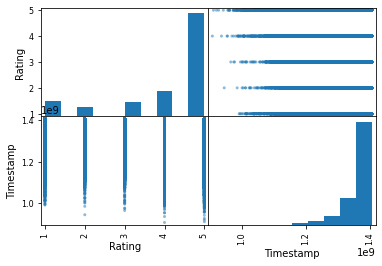

In [64]:
#plotScatterMatrix(df, 6, 15)
pd.plotting.scatter_matrix(df)

In [66]:
#As data is huge so we take a fraction of the data so that we can create a user item matrix. 

data1 = df.head(10000)
ratings_utility_matrix = data1.pivot_table(values='Rating', index='UserId', columns='ProductId')
ratings_utility_matrix.head()

ProductId,0205616461,0558925278,0733001998,0737104473,0762451459,1304139212,1304139220,130414089X,130414643X,1304146537,...,B000052YPE,B000052YPF,B000052YPG,B000052YPH,B000052YPM,B000052YPU,B000052YPV,B000052YPY,B000052YQ0,B000052YQ2
UserId,,,,,,,,,,,,,,,,,,,,,
A00205921JHJK5X9LNP42,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A024581134CV80ZBLIZTZ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A03056581JJIOL5FSKJY7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A03099101ZRK4K607JVHH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A0505229A7NSH3FRXRR4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot:ylabel='Rating'>

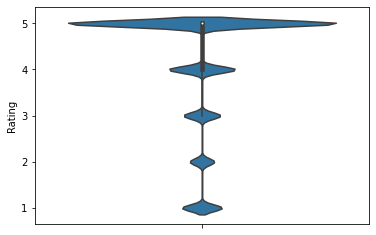

In [67]:
sns.violinplot(y = df.Rating)

<AxesSubplot:ylabel='Rating'>

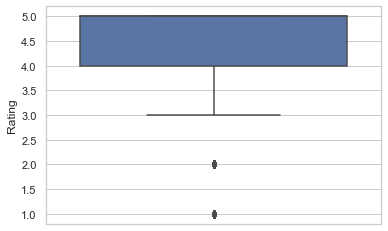

In [68]:
sns.set(style="whitegrid")
sns.boxplot(y = df['Rating'])